In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image
import keras
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Input, Conv2DTranspose, Concatenate, BatchNormalization, UpSampling2D
from tensorflow.keras.layers import  Dropout, Activation
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from tensorflow.keras import backend as K
# from keras.utils import plot_model
import glob
import random
import cv2
from random import shuffle, randint, getrandbits
tf.device('/physical_device:GPU:0')

In [2]:
def mean_iou(y_true, y_pred):
    ious = []
    for i in range(0, 5):  # для 4 классов
        yt = y_true[:, :, :, 0]
        yp = K.cast(y_pred[:, :, :, i] > 0.5, 'float32')  # бинаризация предсказаний для класса i

        # Вычисляем пересечение и объединение, преобразуя булевы тензоры в float
        intersection = tf.reduce_sum(tf.cast(tf.logical_and(tf.equal(yt, 1), tf.equal(yp, 1)), 'float32'))
        union = tf.reduce_sum(tf.cast(tf.logical_or(tf.equal(yt, 1), tf.equal(yp, 1)), 'float32'))

        # Обработка случая, когда union=0
        iou = tf.where(tf.equal(union, 0), 1.0, intersection / union)
        ious.append(iou)

    # Среднее по классам
    mean_iou = tf.reduce_mean(tf.stack(ious))
    return mean_iou

num_classes = 5



In [3]:
def unet(sz = (256, 256, 3), num_classes=4):
    x = Input(sz)
    inputs = x
  
    #down sampling 
    f = 8
    layers = []
  
    for i in range(0, 6):
        x = Conv2D(f, 3, activation='relu', padding='same') (x)
        x = Conv2D(f, 3, activation='relu', padding='same') (x)
        layers.append(x)
        x = MaxPooling2D() (x)
        f = f*2
    ff2 = 64 
  
  #bottleneck 
    j = len(layers) - 1
    x = Conv2D(f, 3, activation='relu', padding='same') (x)
    x = Conv2D(f, 3, activation='relu', padding='same') (x)
    x = Conv2DTranspose(ff2, 2, strides=(2, 2), padding='same') (x)
    x = Concatenate(axis=3)([x, layers[j]])
    j = j -1 
  
  #upsampling 
    for i in range(0, 5):
        ff2 = ff2//2
        f = f // 2 
        x = Conv2D(f, 3, activation='relu', padding='same') (x)
        x = Conv2D(f, 3, activation='relu', padding='same') (x)
        x = Conv2DTranspose(ff2, 2, strides=(2, 2), padding='same') (x)
        x = Concatenate(axis=3)([x, layers[j]])
        j = j -1 
    
  
  #classification 
    x = Conv2D(f, 3, activation='relu', padding='same') (x)
    x = Conv2D(f, 3, activation='relu', padding='same') (x)

    outputs = Conv2D(num_classes, 1, activation='softmax')(x)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=[mean_iou])
    return model

model = unet(num_classes=num_classes)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 8)  224         ['input_1[0][0]']                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 256, 256, 8)  584         ['conv2d[0][0]']                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 128, 128, 8)  0           ['conv2d_1[0][0]']           

In [4]:
datasets_name = "jpeg_dataset_biuld"
path_dataset = f"datasets_biuld_damage/{datasets_name}"
folder_chkpt = f"Segments/{datasets_name}"

In [5]:
def image_generator(files, batch_size=32, sz=(256, 256), num_classes=5):  # Указывайте num_classes здесь
    while True:
        batch = np.random.choice(files, size=batch_size)
        batch_x = []
        batch_y = []

        for f in batch:
            # загрузка изображения
            raw = Image.open(f'{path_dataset}/images/{f}')
            raw = np.array(raw)
            raw = cv2.resize(raw, sz, interpolation=cv2.INTER_CUBIC)
            
            rotate = bool(random.getrandbits(1))
            # if rotate:
                # raw = cv2.rotate(raw, cv2.ROTATE_90_CLOCKWISE)
            batch_x.append(raw)

            # загрузка и обработка маски
            mask = cv2.imread(f'{path_dataset}/masks/{f}')
            mask = cv2.resize(mask, sz, interpolation=cv2.INTER_NEAREST) # Важно для масок!
            mask = cv2.cvtColor(mask, cv2.COLOR_BGR2HSV)
            mask = process_mask_hsv(mask, num_classes)  # Используем функцию на основе HSV
            batch_y.append(mask)
            # plt.imshow(mask)
            # plt.show()
            # plt.imshow(raw)
            # plt.show()

        batch_x = np.array(batch_x)/255.
        batch_y = np.array(batch_y)
        # преобразование к one-hot, если нужно
        batch_y = keras.utils.to_categorical(batch_y, num_classes=num_classes)

        yield batch_x, batch_y


def process_mask_hsv(mask, num_classes):
    """
    Преобразует HSV-маску в маску классов.

    Аргументы:
        mask: HSV-маска (np.array).
        num_classes: Общее количество классов.

    Возвращает:
        Маску классов (np.array) с целыми числами от 0 до num_classes-1.
    """

    class_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.uint8)

    # Определите диапазоны HSV для каждого класса (зеленый, желтый, оранжевый, красный)
    # Эти диапазоны могут потребовать точной настройки под ваш конкретный датасет!
    green_lower = np.array([30, 40, 40])
    green_upper = np.array([80, 255, 255])

    yellow_lower = np.array([20, 40, 40])
    yellow_upper = np.array([30, 255, 255])

    orange_lower = np.array([5, 40, 40])
    orange_upper = np.array([20, 255, 255])

    red_lower1 = np.array([0, 40, 40])
    red_upper1 = np.array([5, 255, 255])

    red_lower2 = np.array([170, 40, 40])
    red_upper2 = np.array([180, 255, 255])


    # Присвойте класс на основе попадания в диапазон HSV
    green_mask = cv2.inRange(mask, green_lower, green_upper)
    yellow_mask = cv2.inRange(mask, yellow_lower, yellow_upper)
    orange_mask = cv2.inRange(mask, orange_lower, orange_upper)
    red_mask1 = cv2.inRange(mask, red_lower1, red_upper1)
    red_mask2 = cv2.inRange(mask, red_lower2, red_upper2)
    red_mask = cv2.bitwise_or(red_mask1, red_mask2)  # Объединяем два диапазона красного

    class_mask[green_mask > 0] = 1  # Класс 1: зеленый
    class_mask[yellow_mask > 0] = 2 # Класс 2: желтый
    class_mask[orange_mask > 0] = 3 # Класс 3: оранжевый
    class_mask[red_mask > 0] = 4    # Класс 4: красный
    
    # Класс 0 остается для фона (где ни один из диапазонов не попадает)

    return class_mask

In [6]:
batch_size = 150
epochs = 100
all_files = os.listdir(f'{path_dataset}/images')#[:1000]
shuffle(all_files)
split = int(0.95 * len(all_files))
#split into training and testing
train_files = all_files[0:split]
test_files  = all_files[split:]
train_generator = image_generator(train_files, batch_size = batch_size, num_classes=num_classes)
test_generator  = image_generator(test_files, batch_size = batch_size, num_classes=num_classes)

In [7]:
n_learn = 6
def build_callbacks():
    reduce_lr = ReduceLROnPlateau(monitor='val_mean_iou', factor=0.3,
                              patience=5, min_lr=0.0005)
    os.makedirs(f'chkpt/Unet/{folder_chkpt}/learn_{n_learn}', exist_ok=True)
    checkpointer = ModelCheckpoint(filepath='chkpt/Unet/'+str(folder_chkpt)+'/learn_'+str(n_learn)+'/model_{epoch:02d}loss_{val_loss:.3f}_mi_{val_mean_iou:.2f}.h5', verbose=1, monitor='val_mean_iou', mode="max", save_best_only=True, save_weights_only=True)
    callbacks = [checkpointer, reduce_lr, PlotLearning()]
    return callbacks

class PlotLearning(tf.keras.callbacks.Callback):

    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        self.acc = []
        self.val_acc = []
        #self.fig = plt.figure()
        self.logs = []
    
    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.acc.append(logs.get('mean_iou'))
        self.val_acc.append(logs.get('val_mean_iou'))
        self.i += 1
        print('i=',self.i,'loss=',logs.get('loss'),'val_loss=',logs.get('val_loss'),'mean_iou=',logs.get('mean_iou'),'val_mean_iou=',logs.get('val_mean_iou'))
        
        # выбираем случайный тестовый файл
        path = np.random.choice(test_files)
        raw = Image.open(f'{path_dataset}/images/{path}')
        raw = np.array(raw.resize((256, 256))) / 255
        raw = raw[:, :, 0:3]
        mask_true = Image.open(f'{path_dataset}/masks/{path}')
        mask_true = np.array(mask_true.resize((256, 256)))

        # предсказание маски
        pred = model.predict(np.expand_dims(raw, 0))
        msk = pred.squeeze()
        print(msk.shape)
        # предполагается, что модель возвращает массив с 4 каналами (4 класса)
        # создаем бинарные маски для каждого класса
        msk_bin = np.zeros((256, 256, 5), dtype=np.uint8)
        for c in range(0, 5):
            # бинаризация каждого канала
            channel_mask = msk[..., c]
            print(channel_mask.shape)
            # порог
            channel_mask_bin = (channel_mask >= 0.5).astype(np.uint8) * 255
            msk_bin[..., c] = channel_mask_bin
            print(c)
            # plt.imshow(msk_bin[..., c])
            # plt.show()

        # также бинарная истинная маска по каналам
        # mask_true_bin = (mask_true[..., 0] >= 0.5).astype(np.uint8) * 255

        # Находим контуры для каждого класса
        contours_per_class = []
        colors = [
            (0, 0, 0),
            (0, 255, 0),    # класс 1
            (255, 255, 0),    # класс 2
            (255, 127, 0),    # класс 1
            (255, 0, 0)
        ]  # цвета для каждого класса
        for c in range(1, 5):
            contours, _ = cv2.findContours(msk_bin[..., c], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contours_per_class.append((contours, colors[c]))

        # Создаем копию исходного изображения для рисования
        result_img = (raw * 255).astype(np.uint8).copy()

        # Рисуем контуры для каждого класса
        for contours, color in contours_per_class:
            if len(contours) > 0:
                cv2.drawContours(result_img, contours, -1, color, 1)

        plt.imshow(result_img)
        plt.axis('off')
        plt.show()

        
    def on_train_end(self, logs=None):
        fig, axs = plt.subplots(2)
       
        axs[0].plot(self.x, self.acc, marker = 'o', ms=4, label="Train")
        axs[0].plot(self.x, self.val_acc, marker = 'o', ms=4, label="Validation")
        axs[0].set_xlabel("Epochs, Num")
        axs[0].legend()
        axs[0].set_ylabel("Value Accuracy (Mean IOU), %")
        axs[0].set_xticks(np.arange(min(self.x), max(self.x)+1, 1.0))
        axs[0].grid()

        axs[1].plot(self.x, self.losses, marker = 'o', ms=4, label="Train")
        axs[1].plot(self.x, self.val_losses, marker = 'o', ms=4, label="Validation")
        axs[1].set_xlabel("Epochs, Num")
        axs[1].legend()
        axs[1].set_ylabel("Value Loss, %")
        axs[1].set_xticks(np.arange(min(self.x), max(self.x)+1, 1.0))
        axs[1].grid()
        plt.savefig('chkpt/Unet/'+str(folder_chkpt)+'/learn_'+str(n_learn)+'.png')
        import pandas as pd
        data = {
            'epochs': self.x,
            'train_acc': self.acc,
            'val_acc': self.val_acc,
            'train_loss': self.losses,
            'valid_loss': self.val_losses
        }
        df = pd.DataFrame(data)
        df.to_csv('chkpt/Unet/'+str(folder_chkpt)+'/learn_'+str(n_learn)+'.csv')

        plt.show()

In [8]:
x, y = next(train_generator)

C:\Users\User\AppData\Local\Temp\ipykernel_15384\3844390882.py:4: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model.fit_generator(train_generator,



Epoch 1: val_mean_iou improved from -inf to 0.19131, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_01loss_0.148_mi_0.19.h5
i= 1 loss= 0.19173139333724976 val_loss= 0.1479465216398239 mean_iou= 0.18943476676940918 val_mean_iou= 0.1913108080625534
1/1 [==============================] - 1s 502ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


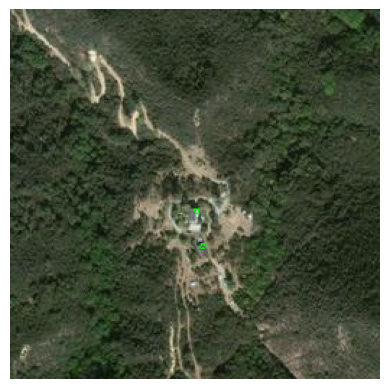


Epoch 2: val_mean_iou improved from 0.19131 to 0.19287, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_02loss_0.135_mi_0.19.h5
i= 2 loss= 0.16591660678386688 val_loss= 0.13547462224960327 mean_iou= 0.1909419447183609 val_mean_iou= 0.1928684115409851
1/1 [==============================] - 0s 10ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


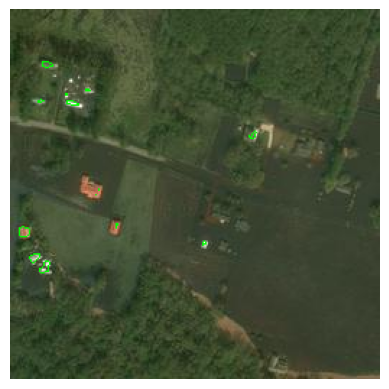


Epoch 3: val_mean_iou did not improve from 0.19287
i= 3 loss= 0.15552997589111328 val_loss= 0.14115700125694275 mean_iou= 0.1918613165616989 val_mean_iou= 0.19240637123584747
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


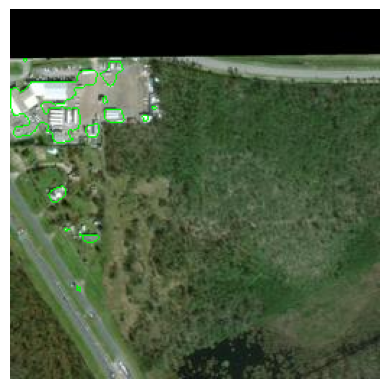


Epoch 4: val_mean_iou did not improve from 0.19287
i= 4 loss= 0.14627641439437866 val_loss= 0.15907712280750275 mean_iou= 0.1924009770154953 val_mean_iou= 0.19160383939743042
1/1 [==============================] - 0s 34ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


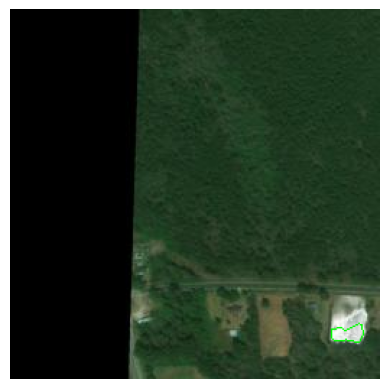


Epoch 5: val_mean_iou did not improve from 0.19287
i= 5 loss= 0.14550715684890747 val_loss= 0.12740711867809296 mean_iou= 0.19234181940555573 val_mean_iou= 0.19260522723197937
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


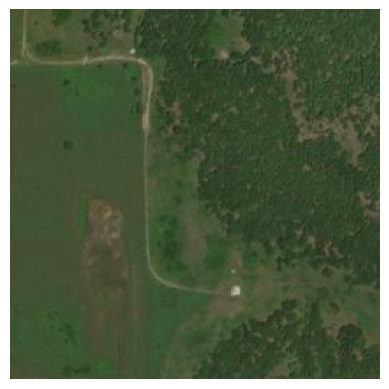


Epoch 6: val_mean_iou did not improve from 0.19287
i= 6 loss= 0.1427132934331894 val_loss= 0.13606008887290955 mean_iou= 0.19248732924461365 val_mean_iou= 0.1927529126405716
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


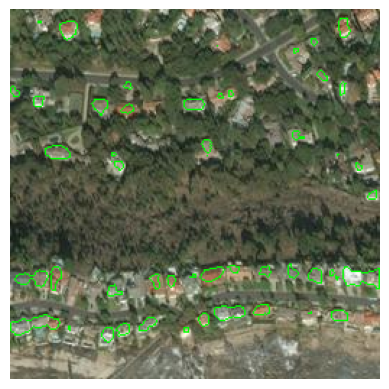


Epoch 7: val_mean_iou did not improve from 0.19287
i= 7 loss= 0.13076427578926086 val_loss= 0.14510829746723175 mean_iou= 0.19318588078022003 val_mean_iou= 0.19201020896434784
1/1 [==============================] - 0s 18ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


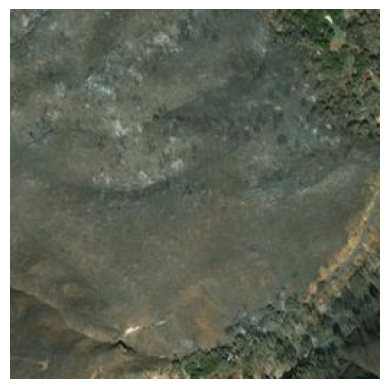


Epoch 8: val_mean_iou did not improve from 0.19287
i= 8 loss= 0.12866199016571045 val_loss= 0.16519522666931152 mean_iou= 0.1932574212551117 val_mean_iou= 0.19145698845386505
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


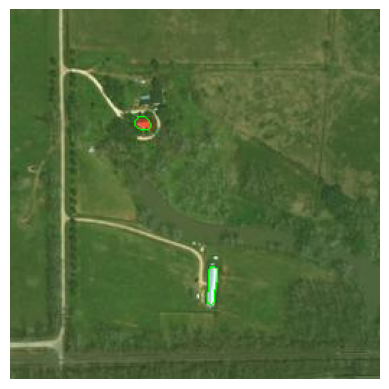


Epoch 9: val_mean_iou improved from 0.19287 to 0.19316, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_09loss_0.122_mi_0.19.h5
i= 9 loss= 0.1291949450969696 val_loss= 0.12191706150770187 mean_iou= 0.19309304654598236 val_mean_iou= 0.19316238164901733
1/1 [==============================] - 0s 7ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


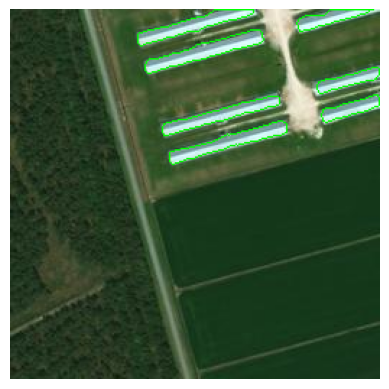


Epoch 10: val_mean_iou did not improve from 0.19316
i= 10 loss= 0.11928949505090714 val_loss= 0.16165609657764435 mean_iou= 0.19371522963047028 val_mean_iou= 0.19294652342796326
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


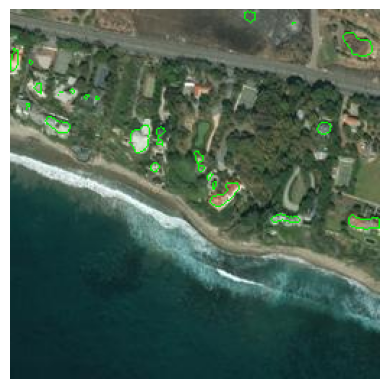


Epoch 11: val_mean_iou did not improve from 0.19316
i= 11 loss= 0.1196853518486023 val_loss= 0.16211426258087158 mean_iou= 0.19362269341945648 val_mean_iou= 0.19151486456394196
1/1 [==============================] - 0s 28ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


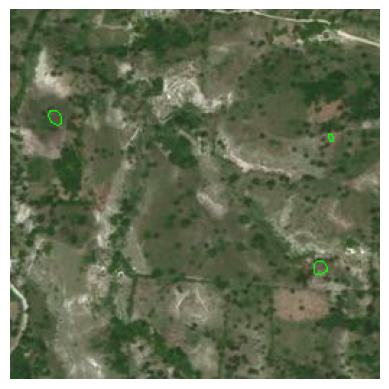


Epoch 12: val_mean_iou improved from 0.19316 to 0.19424, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_12loss_0.127_mi_0.19.h5
i= 12 loss= 0.1169968843460083 val_loss= 0.12659406661987305 mean_iou= 0.19382339715957642 val_mean_iou= 0.19423843920230865
1/1 [==============================] - 0s 15ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


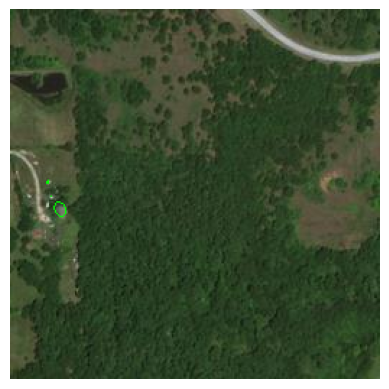


Epoch 13: val_mean_iou did not improve from 0.19424
i= 13 loss= 0.1175447329878807 val_loss= 0.1179109439253807 mean_iou= 0.1937210112810135 val_mean_iou= 0.1939030885696411
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


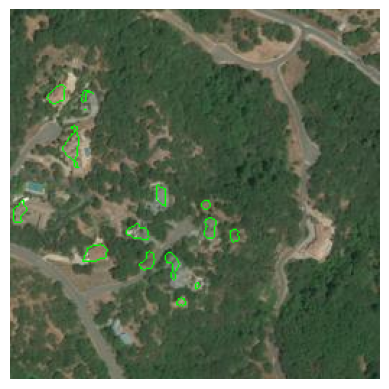


Epoch 14: val_mean_iou did not improve from 0.19424
i= 14 loss= 0.10866715759038925 val_loss= 0.15322701632976532 mean_iou= 0.19419696927070618 val_mean_iou= 0.19263312220573425
1/1 [==============================] - 0s 15ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


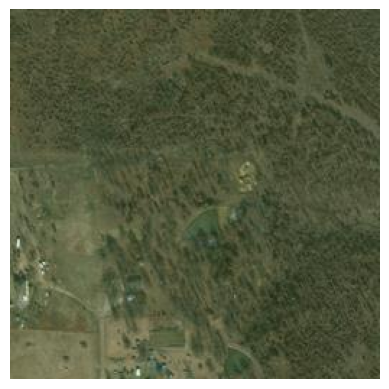


Epoch 15: val_mean_iou did not improve from 0.19424
i= 15 loss= 0.1111387386918068 val_loss= 0.1628127098083496 mean_iou= 0.19403018057346344 val_mean_iou= 0.192378968000412
1/1 [==============================] - 0s 18ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


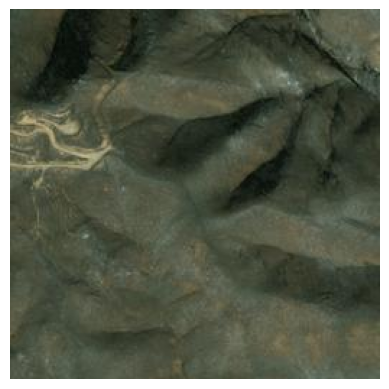


Epoch 16: val_mean_iou did not improve from 0.19424
i= 16 loss= 0.10196495801210403 val_loss= 0.15798602998256683 mean_iou= 0.19455355405807495 val_mean_iou= 0.19331136345863342
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


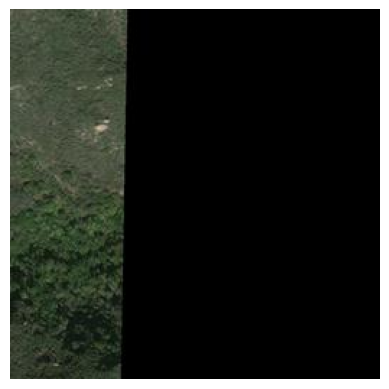


Epoch 17: val_mean_iou did not improve from 0.19424
i= 17 loss= 0.10262211412191391 val_loss= 0.14143185317516327 mean_iou= 0.19443757832050323 val_mean_iou= 0.19363805651664734
1/1 [==============================] - 0s 21ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


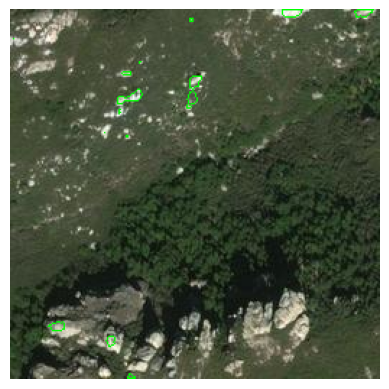


Epoch 18: val_mean_iou did not improve from 0.19424
i= 18 loss= 0.10251422971487045 val_loss= 0.16936317086219788 mean_iou= 0.19449634850025177 val_mean_iou= 0.19230185449123383
1/1 [==============================] - 0s 23ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


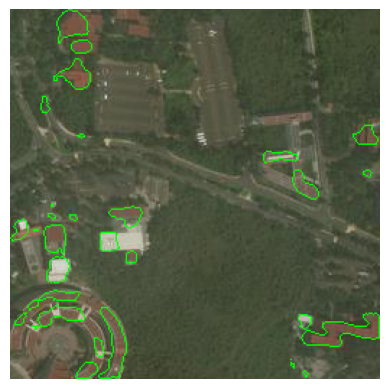


Epoch 19: val_mean_iou did not improve from 0.19424
i= 19 loss= 0.09631631523370743 val_loss= 0.18556426465511322 mean_iou= 0.19479888677597046 val_mean_iou= 0.19238343834877014
1/1 [==============================] - 0s 6ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


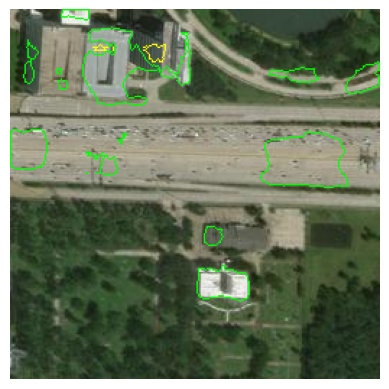


Epoch 20: val_mean_iou did not improve from 0.19424
i= 20 loss= 0.09526723623275757 val_loss= 0.1564142107963562 mean_iou= 0.19489844143390656 val_mean_iou= 0.1933836042881012
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


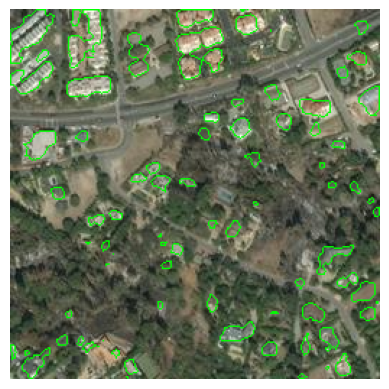


Epoch 21: val_mean_iou did not improve from 0.19424
i= 21 loss= 0.09416533261537552 val_loss= 0.15113995969295502 mean_iou= 0.19492743909358978 val_mean_iou= 0.19364836812019348
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


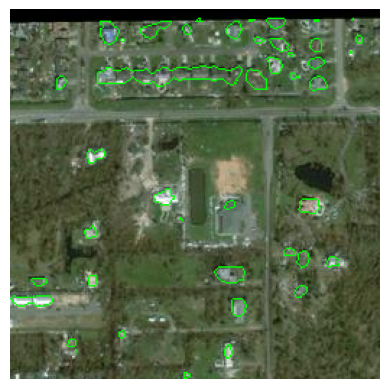


Epoch 22: val_mean_iou did not improve from 0.19424
i= 22 loss= 0.09129774570465088 val_loss= 0.2032676488161087 mean_iou= 0.19511066377162933 val_mean_iou= 0.19235074520111084
1/1 [==============================] - 0s 24ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


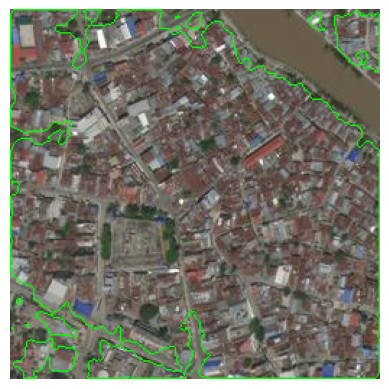


Epoch 23: val_mean_iou did not improve from 0.19424
i= 23 loss= 0.09055429697036743 val_loss= 0.16092132031917572 mean_iou= 0.19513294100761414 val_mean_iou= 0.1933118849992752
1/1 [==============================] - 0s 18ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


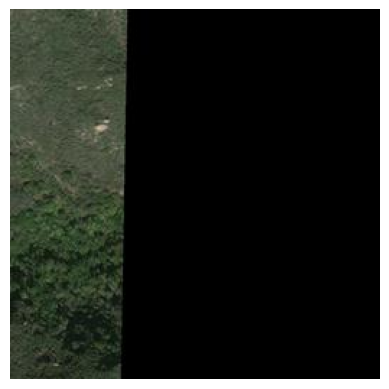


Epoch 24: val_mean_iou did not improve from 0.19424
i= 24 loss= 0.09384668618440628 val_loss= 0.17403873801231384 mean_iou= 0.19492791593074799 val_mean_iou= 0.19260957837104797
1/1 [==============================] - 0s 5ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


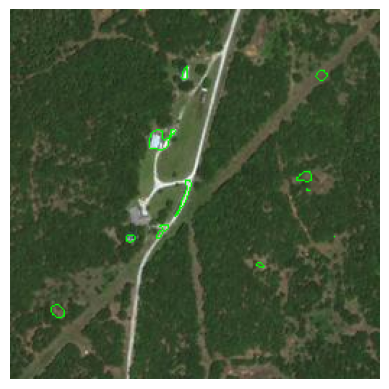


Epoch 25: val_mean_iou improved from 0.19424 to 0.19435, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_25loss_0.142_mi_0.19.h5
i= 25 loss= 0.08549279719591141 val_loss= 0.141619473695755 mean_iou= 0.19544564187526703 val_mean_iou= 0.1943475902080536
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


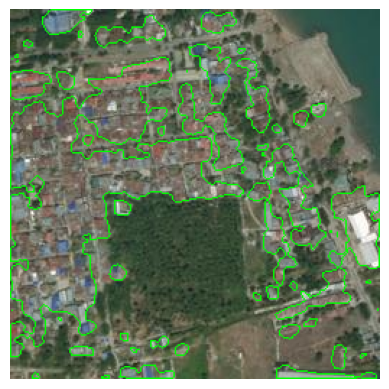


Epoch 26: val_mean_iou did not improve from 0.19435
i= 26 loss= 0.08773291856050491 val_loss= 0.1721450686454773 mean_iou= 0.19530218839645386 val_mean_iou= 0.19253702461719513
1/1 [==============================] - 0s 33ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


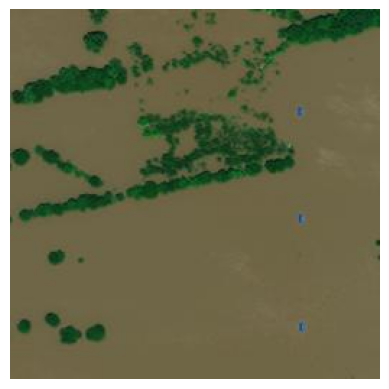


Epoch 27: val_mean_iou did not improve from 0.19435
i= 27 loss= 0.08640611916780472 val_loss= 0.21324247121810913 mean_iou= 0.1953880786895752 val_mean_iou= 0.19198597967624664
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


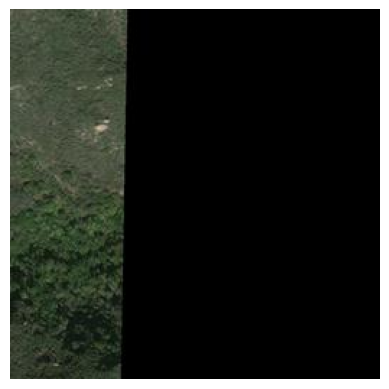


Epoch 28: val_mean_iou did not improve from 0.19435
i= 28 loss= 0.08271965384483337 val_loss= 0.14638736844062805 mean_iou= 0.1956237107515335 val_mean_iou= 0.19433844089508057
1/1 [==============================] - 0s 28ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


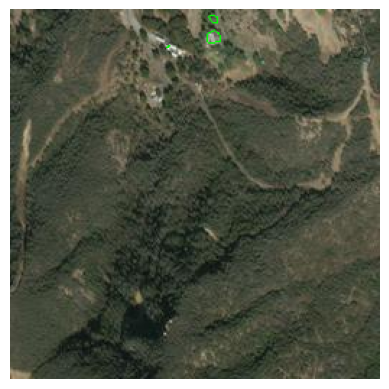


Epoch 29: val_mean_iou did not improve from 0.19435
i= 29 loss= 0.08212411403656006 val_loss= 0.17799071967601776 mean_iou= 0.195637047290802 val_mean_iou= 0.19417420029640198
1/1 [==============================] - 0s 17ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


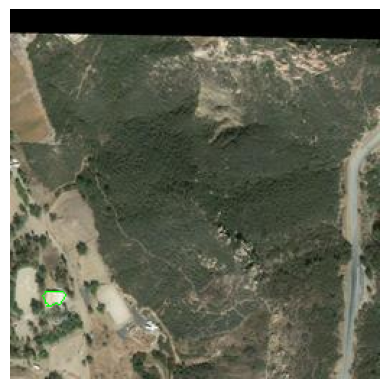


Epoch 30: val_mean_iou improved from 0.19435 to 0.19452, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_30loss_0.150_mi_0.19.h5
i= 30 loss= 0.07885009050369263 val_loss= 0.1495281159877777 mean_iou= 0.19585739076137543 val_mean_iou= 0.19451628625392914
1/1 [==============================] - 0s 34ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


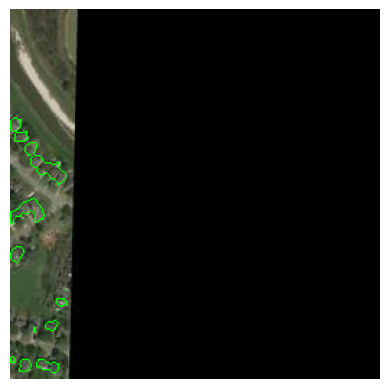


Epoch 31: val_mean_iou did not improve from 0.19452
i= 31 loss= 0.07933828234672546 val_loss= 0.1908646523952484 mean_iou= 0.1958800107240677 val_mean_iou= 0.19332368671894073
1/1 [==============================] - 0s 25ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


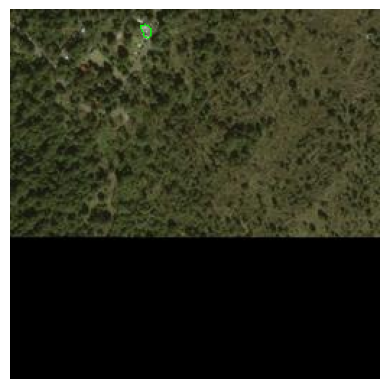


Epoch 32: val_mean_iou did not improve from 0.19452
i= 32 loss= 0.07826133072376251 val_loss= 0.17554035782814026 mean_iou= 0.19590941071510315 val_mean_iou= 0.19417014718055725
1/1 [==============================] - 0s 18ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


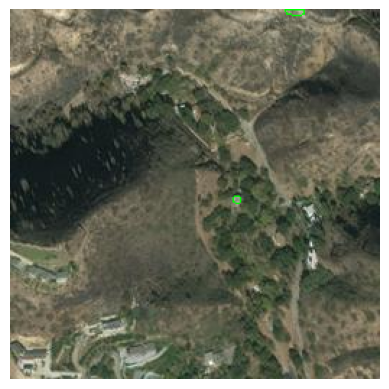


Epoch 33: val_mean_iou improved from 0.19452 to 0.19474, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_33loss_0.137_mi_0.19.h5
i= 33 loss= 0.0759352371096611 val_loss= 0.13731352984905243 mean_iou= 0.196025550365448 val_mean_iou= 0.19474196434020996
1/1 [==============================] - 0s 18ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


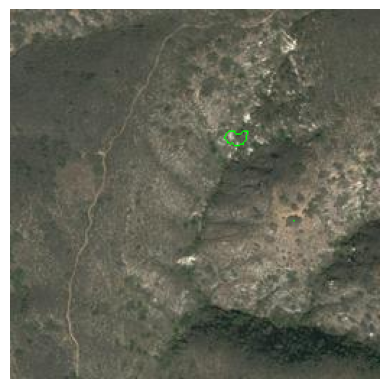


Epoch 34: val_mean_iou did not improve from 0.19474
i= 34 loss= 0.07815791666507721 val_loss= 0.15440340340137482 mean_iou= 0.1959424614906311 val_mean_iou= 0.1937040090560913
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


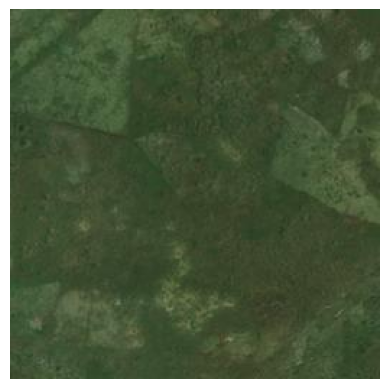


Epoch 35: val_mean_iou did not improve from 0.19474
i= 35 loss= 0.0765611082315445 val_loss= 0.1410854309797287 mean_iou= 0.19604097306728363 val_mean_iou= 0.19440411031246185
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


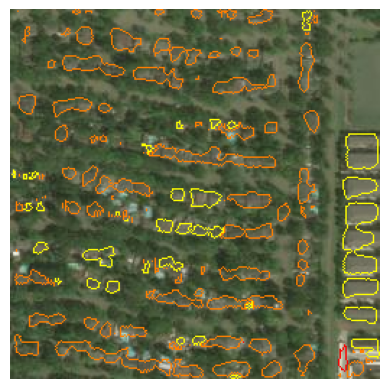


Epoch 36: val_mean_iou did not improve from 0.19474
i= 36 loss= 0.0713949054479599 val_loss= 0.16837961971759796 mean_iou= 0.19634577631950378 val_mean_iou= 0.19306983053684235
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


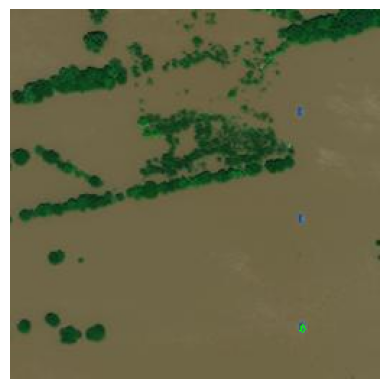


Epoch 37: val_mean_iou did not improve from 0.19474
i= 37 loss= 0.07375660538673401 val_loss= 0.22928975522518158 mean_iou= 0.19617927074432373 val_mean_iou= 0.19292545318603516
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


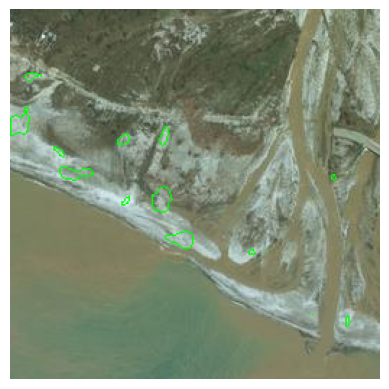


Epoch 38: val_mean_iou did not improve from 0.19474
i= 38 loss= 0.07280784100294113 val_loss= 0.15569284558296204 mean_iou= 0.19625695049762726 val_mean_iou= 0.1941453516483307
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


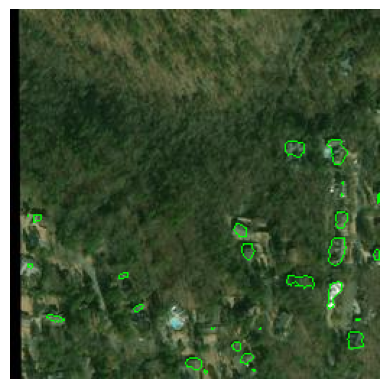


Epoch 39: val_mean_iou did not improve from 0.19474
i= 39 loss= 0.07230166345834732 val_loss= 0.1819976270198822 mean_iou= 0.19629745185375214 val_mean_iou= 0.19291415810585022
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


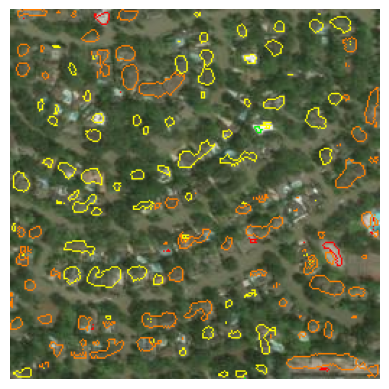


Epoch 40: val_mean_iou did not improve from 0.19474
i= 40 loss= 0.07007122039794922 val_loss= 0.16553404927253723 mean_iou= 0.19640691578388214 val_mean_iou= 0.19399383664131165
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


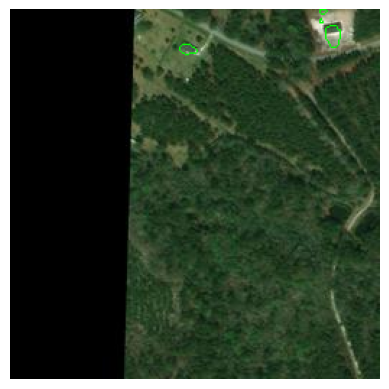


Epoch 41: val_mean_iou did not improve from 0.19474
i= 41 loss= 0.07213471829891205 val_loss= 0.15365751087665558 mean_iou= 0.19634172320365906 val_mean_iou= 0.19401122629642487
1/1 [==============================] - 0s 32ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


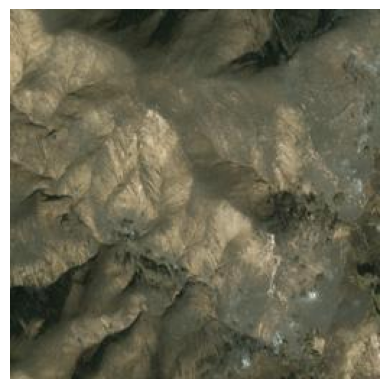


Epoch 42: val_mean_iou did not improve from 0.19474
i= 42 loss= 0.07177899777889252 val_loss= 0.15622106194496155 mean_iou= 0.19633276760578156 val_mean_iou= 0.19452905654907227
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


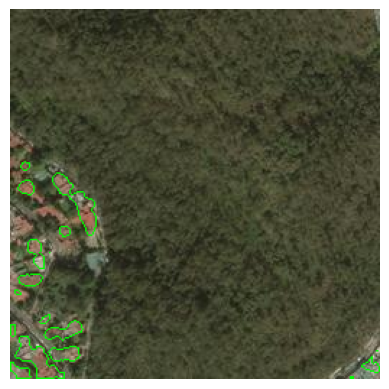


Epoch 43: val_mean_iou did not improve from 0.19474
i= 43 loss= 0.06872370839118958 val_loss= 0.16080956161022186 mean_iou= 0.1964941769838333 val_mean_iou= 0.1940770447254181
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


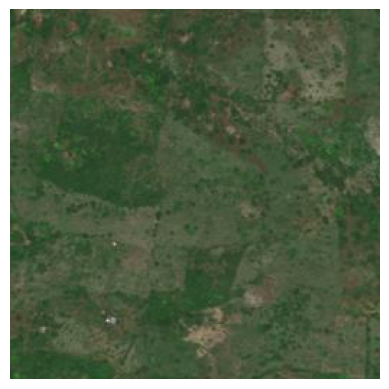


Epoch 44: val_mean_iou did not improve from 0.19474
i= 44 loss= 0.06942624598741531 val_loss= 0.17682957649230957 mean_iou= 0.1964789777994156 val_mean_iou= 0.19367632269859314
1/1 [==============================] - 0s 28ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


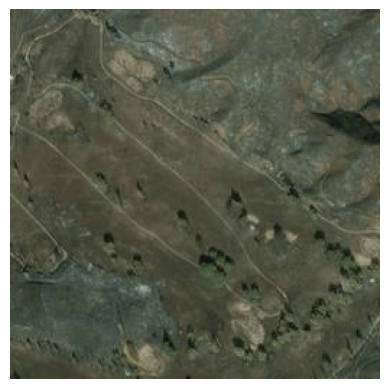


Epoch 45: val_mean_iou did not improve from 0.19474
i= 45 loss= 0.06654106825590134 val_loss= 0.18590420484542847 mean_iou= 0.19665546715259552 val_mean_iou= 0.19318193197250366
1/1 [==============================] - 0s 23ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


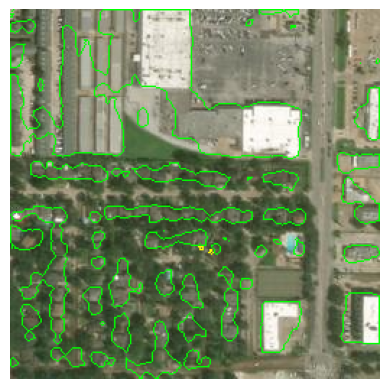


Epoch 46: val_mean_iou improved from 0.19474 to 0.19487, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_46loss_0.165_mi_0.19.h5
i= 46 loss= 0.06496094912290573 val_loss= 0.16480578482151031 mean_iou= 0.19673441350460052 val_mean_iou= 0.1948663294315338
1/1 [==============================] - 0s 14ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


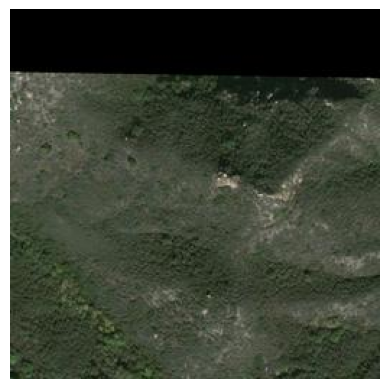


Epoch 47: val_mean_iou did not improve from 0.19487
i= 47 loss= 0.06733790785074234 val_loss= 0.19668452441692352 mean_iou= 0.19663125276565552 val_mean_iou= 0.19295719265937805
1/1 [==============================] - 0s 21ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


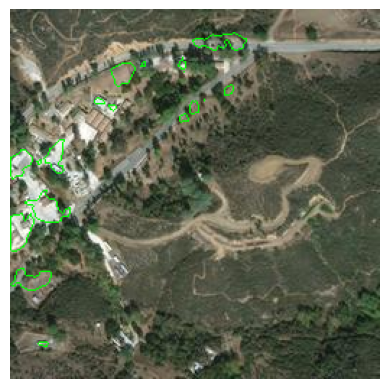


Epoch 48: val_mean_iou did not improve from 0.19487
i= 48 loss= 0.06574095040559769 val_loss= 0.17763887345790863 mean_iou= 0.1967182755470276 val_mean_iou= 0.193513423204422
1/1 [==============================] - 0s 32ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


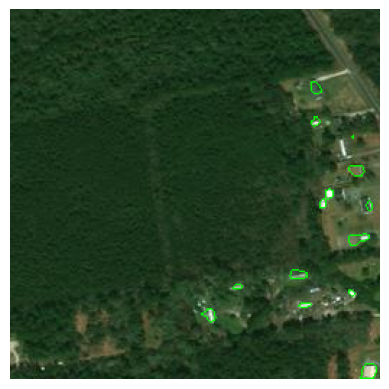


Epoch 49: val_mean_iou did not improve from 0.19487
i= 49 loss= 0.06354659050703049 val_loss= 0.22258391976356506 mean_iou= 0.19681434333324432 val_mean_iou= 0.19360506534576416
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


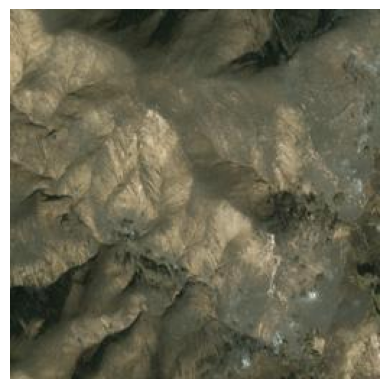


Epoch 50: val_mean_iou did not improve from 0.19487
i= 50 loss= 0.06442507356405258 val_loss= 0.2714288532733917 mean_iou= 0.1967746615409851 val_mean_iou= 0.1908857822418213
1/1 [==============================] - 0s 21ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


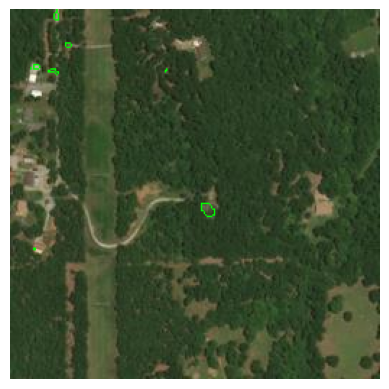


Epoch 51: val_mean_iou did not improve from 0.19487
i= 51 loss= 0.06192346289753914 val_loss= 0.2508229911327362 mean_iou= 0.19692552089691162 val_mean_iou= 0.1924217790365219
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


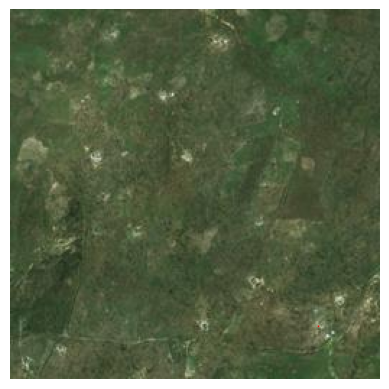


Epoch 52: val_mean_iou did not improve from 0.19487
i= 52 loss= 0.062272507697343826 val_loss= 0.2590544521808624 mean_iou= 0.19688870012760162 val_mean_iou= 0.19078662991523743
1/1 [==============================] - 0s 21ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


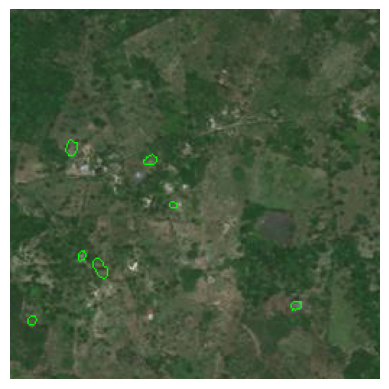


Epoch 53: val_mean_iou did not improve from 0.19487
i= 53 loss= 0.062097035348415375 val_loss= 0.19272588193416595 mean_iou= 0.19692285358905792 val_mean_iou= 0.19350236654281616
1/1 [==============================] - 0s 33ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


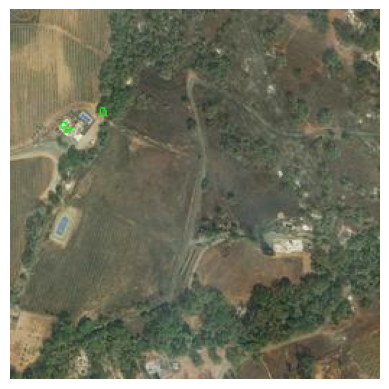


Epoch 54: val_mean_iou did not improve from 0.19487
i= 54 loss= 0.06302732229232788 val_loss= 0.29676029086112976 mean_iou= 0.1968735307455063 val_mean_iou= 0.19162003695964813
1/1 [==============================] - 0s 21ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


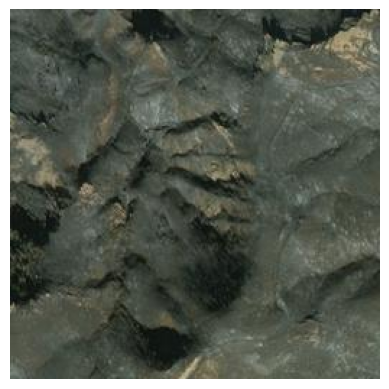


Epoch 55: val_mean_iou did not improve from 0.19487
i= 55 loss= 0.06136161834001541 val_loss= 0.18513041734695435 mean_iou= 0.19695024192333221 val_mean_iou= 0.1936519294977188
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


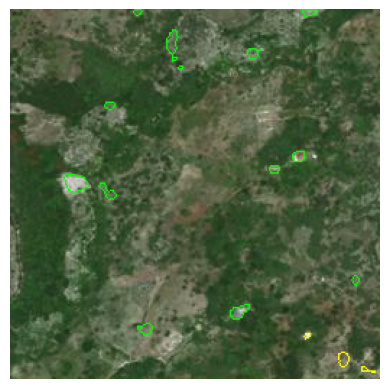


Epoch 56: val_mean_iou did not improve from 0.19487
i= 56 loss= 0.057914964854717255 val_loss= 0.16958339512348175 mean_iou= 0.1971444934606552 val_mean_iou= 0.19431361556053162
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


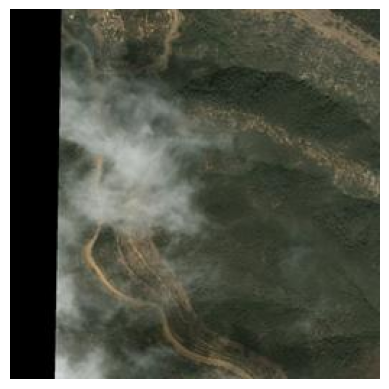


Epoch 57: val_mean_iou did not improve from 0.19487
i= 57 loss= 0.06078793480992317 val_loss= 0.20730097591876984 mean_iou= 0.19698554277420044 val_mean_iou= 0.1939915120601654
1/1 [==============================] - 0s 24ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


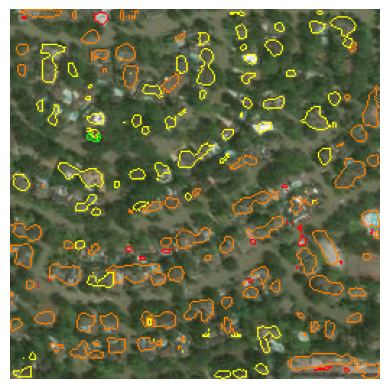


Epoch 58: val_mean_iou did not improve from 0.19487
i= 58 loss= 0.05727905407547951 val_loss= 0.15343531966209412 mean_iou= 0.1971890777349472 val_mean_iou= 0.19486168026924133
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


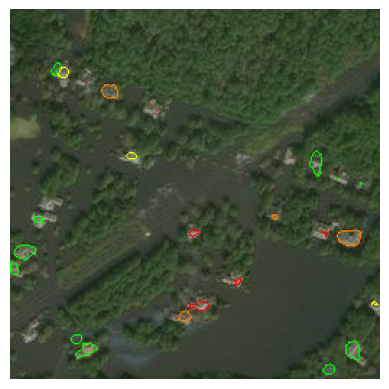


Epoch 59: val_mean_iou did not improve from 0.19487
i= 59 loss= 0.05942721664905548 val_loss= 0.22010010480880737 mean_iou= 0.1970565915107727 val_mean_iou= 0.19434069097042084
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


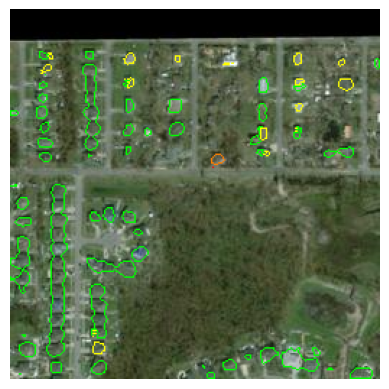


Epoch 60: val_mean_iou did not improve from 0.19487
i= 60 loss= 0.06232475861907005 val_loss= 0.19175906479358673 mean_iou= 0.19690662622451782 val_mean_iou= 0.194373220205307
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


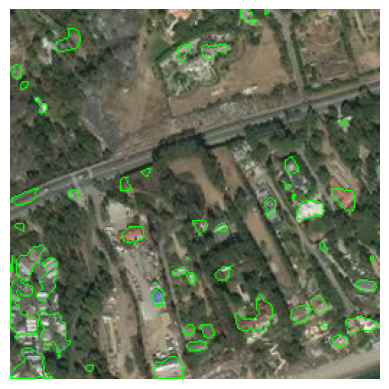


Epoch 61: val_mean_iou did not improve from 0.19487
i= 61 loss= 0.058822061866521835 val_loss= 0.2087612748146057 mean_iou= 0.19710800051689148 val_mean_iou= 0.1938035488128662
1/1 [==============================] - 0s 33ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


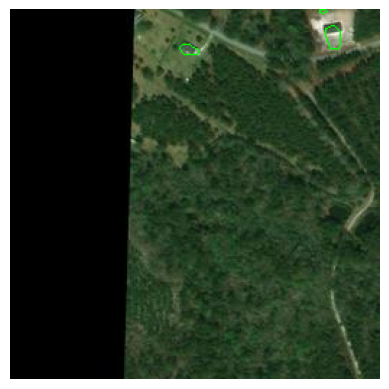


Epoch 62: val_mean_iou did not improve from 0.19487
i= 62 loss= 0.058245278894901276 val_loss= 0.18857035040855408 mean_iou= 0.19712480902671814 val_mean_iou= 0.19420990347862244
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


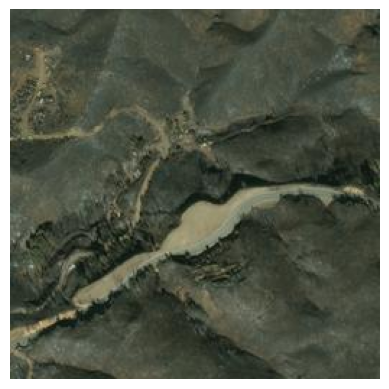


Epoch 63: val_mean_iou did not improve from 0.19487
i= 63 loss= 0.05869368091225624 val_loss= 0.25787317752838135 mean_iou= 0.19712717831134796 val_mean_iou= 0.19280332326889038
1/1 [==============================] - 0s 34ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


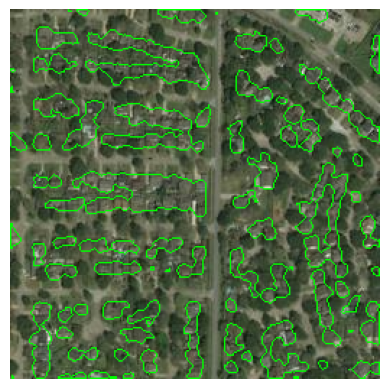


Epoch 64: val_mean_iou did not improve from 0.19487
i= 64 loss= 0.05751313641667366 val_loss= 0.2230197936296463 mean_iou= 0.19716037809848785 val_mean_iou= 0.19348058104515076
1/1 [==============================] - 0s 23ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


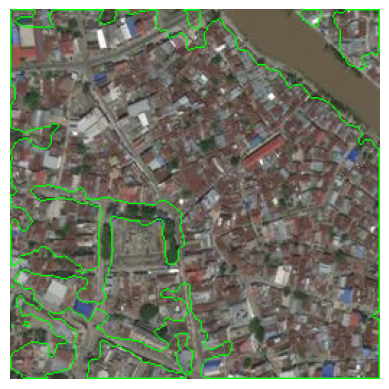


Epoch 65: val_mean_iou did not improve from 0.19487
i= 65 loss= 0.05660277605056763 val_loss= 0.17419356107711792 mean_iou= 0.1972309798002243 val_mean_iou= 0.19417554140090942
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


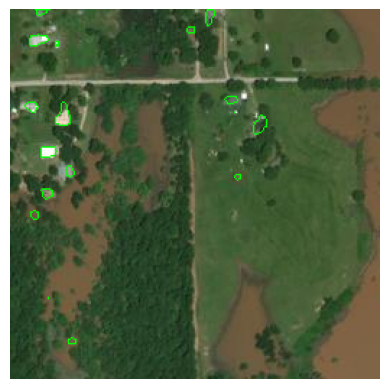


Epoch 66: val_mean_iou did not improve from 0.19487
i= 66 loss= 0.05797188729047775 val_loss= 0.24289117753505707 mean_iou= 0.19714204967021942 val_mean_iou= 0.19286689162254333
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


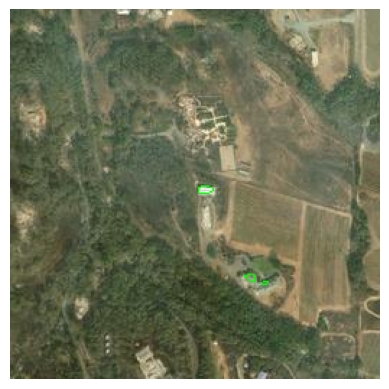


Epoch 67: val_mean_iou did not improve from 0.19487
i= 67 loss= 0.05591617897152901 val_loss= 0.2504507899284363 mean_iou= 0.19726645946502686 val_mean_iou= 0.19182546436786652
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


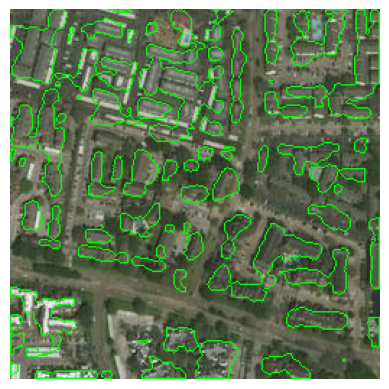


Epoch 68: val_mean_iou did not improve from 0.19487
i= 68 loss= 0.05528030917048454 val_loss= 0.23779360949993134 mean_iou= 0.1973007768392563 val_mean_iou= 0.19307652115821838
1/1 [==============================] - 0s 28ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


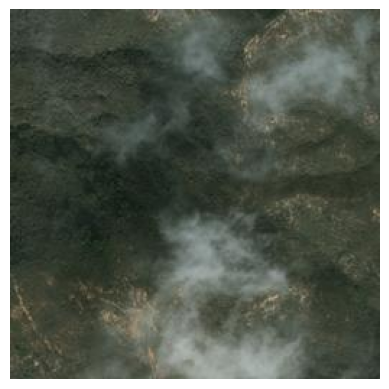


Epoch 69: val_mean_iou did not improve from 0.19487
i= 69 loss= 0.057103533297777176 val_loss= 0.21185146272182465 mean_iou= 0.1972029060125351 val_mean_iou= 0.19396403431892395
1/1 [==============================] - 0s 34ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


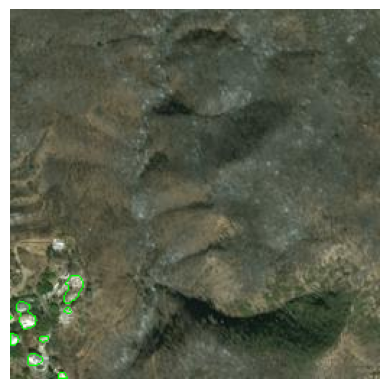


Epoch 70: val_mean_iou did not improve from 0.19487
i= 70 loss= 0.055026303976774216 val_loss= 0.21632885932922363 mean_iou= 0.19732551276683807 val_mean_iou= 0.19315911829471588
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


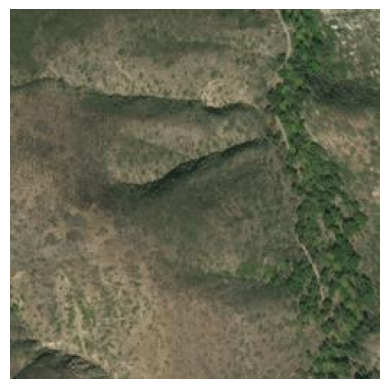


Epoch 71: val_mean_iou did not improve from 0.19487
i= 71 loss= 0.05445180460810661 val_loss= 0.1895914524793625 mean_iou= 0.19736190140247345 val_mean_iou= 0.19416017830371857
1/1 [==============================] - 0s 28ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


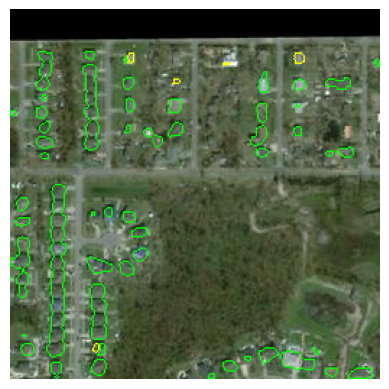


Epoch 72: val_mean_iou did not improve from 0.19487
i= 72 loss= 0.053440045565366745 val_loss= 0.18778063356876373 mean_iou= 0.19740526378154755 val_mean_iou= 0.19385725259780884
1/1 [==============================] - 0s 29ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


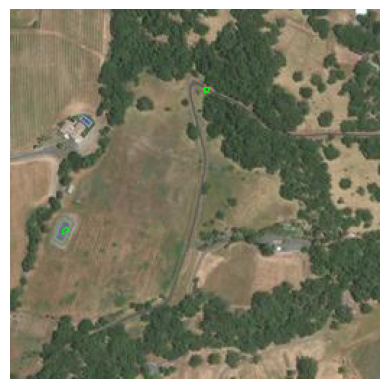


Epoch 73: val_mean_iou did not improve from 0.19487
i= 73 loss= 0.05371016263961792 val_loss= 0.20914743840694427 mean_iou= 0.19740833342075348 val_mean_iou= 0.1928856372833252
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


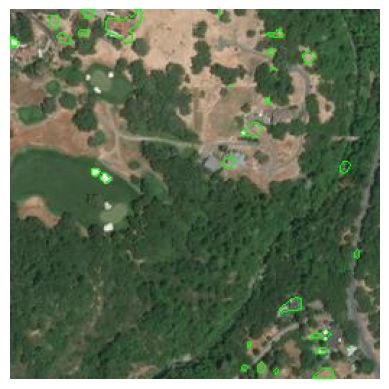


Epoch 74: val_mean_iou did not improve from 0.19487
i= 74 loss= 0.054745111614465714 val_loss= 0.2623859643936157 mean_iou= 0.19734486937522888 val_mean_iou= 0.1928025484085083
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


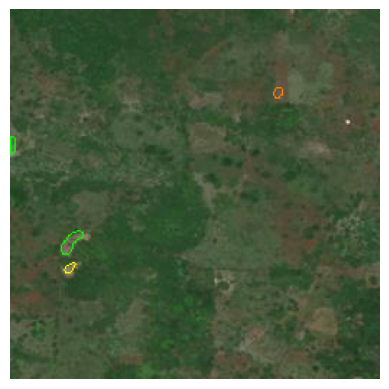


Epoch 75: val_mean_iou did not improve from 0.19487
i= 75 loss= 0.05413849279284477 val_loss= 0.25980231165885925 mean_iou= 0.1973848193883896 val_mean_iou= 0.19255727529525757
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


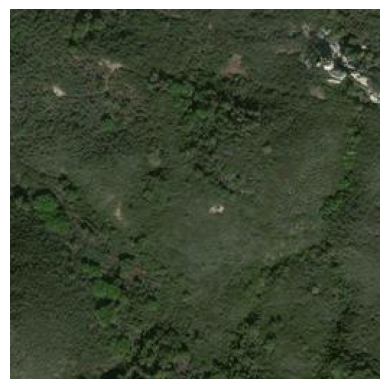


Epoch 76: val_mean_iou did not improve from 0.19487
i= 76 loss= 0.0533941313624382 val_loss= 0.264552503824234 mean_iou= 0.1974099725484848 val_mean_iou= 0.19172939658164978
1/1 [==============================] - 0s 24ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


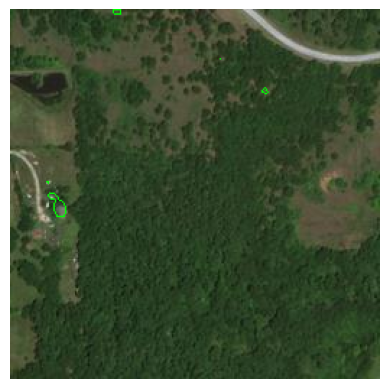


Epoch 77: val_mean_iou did not improve from 0.19487
i= 77 loss= 0.05931827053427696 val_loss= 0.1896095722913742 mean_iou= 0.19707919657230377 val_mean_iou= 0.19409538805484772
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


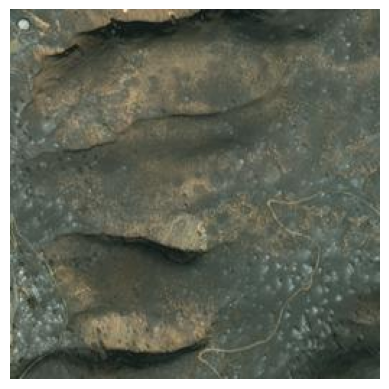


Epoch 78: val_mean_iou did not improve from 0.19487
i= 78 loss= 0.0581231452524662 val_loss= 0.20062291622161865 mean_iou= 0.19712373614311218 val_mean_iou= 0.19407832622528076
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


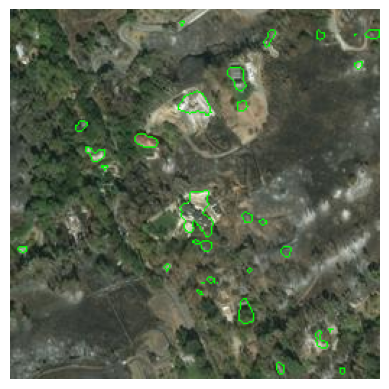


Epoch 79: val_mean_iou did not improve from 0.19487
i= 79 loss= 0.05418194457888603 val_loss= 0.20576323568820953 mean_iou= 0.1973622441291809 val_mean_iou= 0.19446957111358643
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


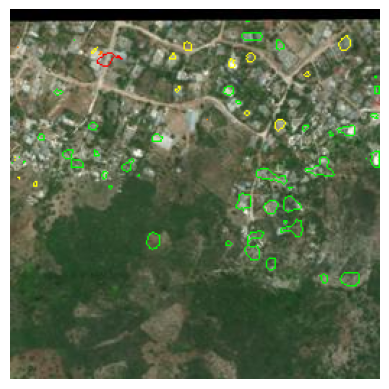


Epoch 80: val_mean_iou did not improve from 0.19487
i= 80 loss= 0.053955160081386566 val_loss= 0.22603386640548706 mean_iou= 0.19739310443401337 val_mean_iou= 0.19382557272911072
1/1 [==============================] - 0s 30ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


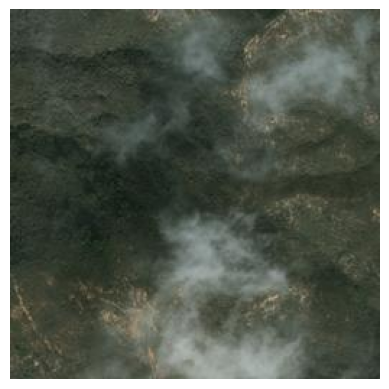


Epoch 81: val_mean_iou did not improve from 0.19487
i= 81 loss= 0.05136337876319885 val_loss= 0.2422434240579605 mean_iou= 0.19752012193202972 val_mean_iou= 0.19303953647613525
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


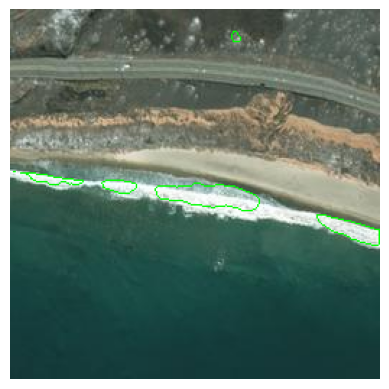


Epoch 82: val_mean_iou did not improve from 0.19487
i= 82 loss= 0.051561303436756134 val_loss= 0.2807949185371399 mean_iou= 0.19751302897930145 val_mean_iou= 0.19207605719566345
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


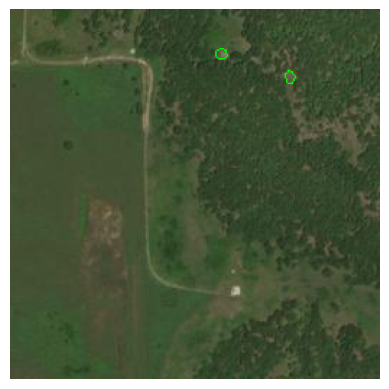


Epoch 83: val_mean_iou did not improve from 0.19487
i= 83 loss= 0.05303962528705597 val_loss= 0.2718864679336548 mean_iou= 0.1974419355392456 val_mean_iou= 0.1917499601840973
1/1 [==============================] - 0s 33ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


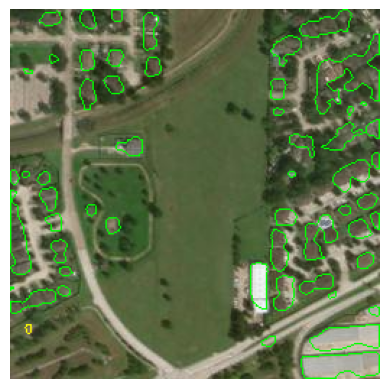


Epoch 84: val_mean_iou did not improve from 0.19487
i= 84 loss= 0.05075043439865112 val_loss= 0.21643824875354767 mean_iou= 0.1975393146276474 val_mean_iou= 0.19397610425949097
1/1 [==============================] - 0s 16ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


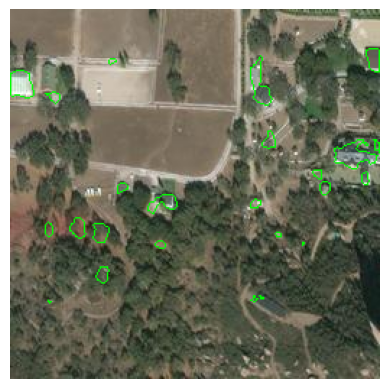


Epoch 85: val_mean_iou did not improve from 0.19487
i= 85 loss= 0.050238095223903656 val_loss= 0.19667482376098633 mean_iou= 0.197585791349411 val_mean_iou= 0.19447022676467896
1/1 [==============================] - 0s 33ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


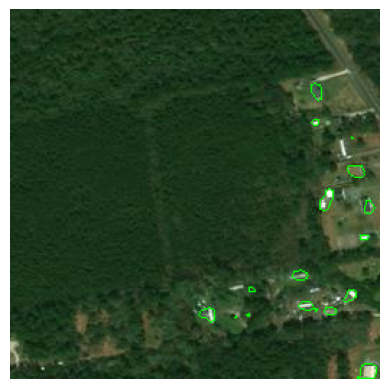


Epoch 86: val_mean_iou did not improve from 0.19487
i= 86 loss= 0.051507554948329926 val_loss= 0.25634393095970154 mean_iou= 0.19753152132034302 val_mean_iou= 0.1924428790807724
1/1 [==============================] - 0s 24ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


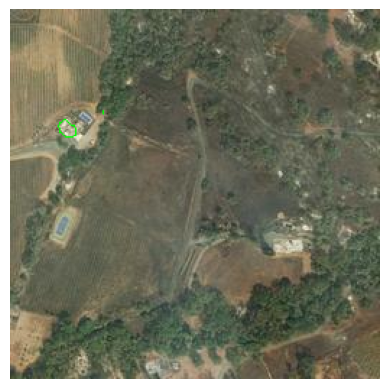


Epoch 87: val_mean_iou improved from 0.19487 to 0.19509, saving model to chkpt/Unet/Segments/jpeg_dataset_biuld/learn_6\model_87loss_0.206_mi_0.20.h5
i= 87 loss= 0.04968506470322609 val_loss= 0.20628386735916138 mean_iou= 0.19760625064373016 val_mean_iou= 0.19508889317512512
1/1 [==============================] - 0s 18ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


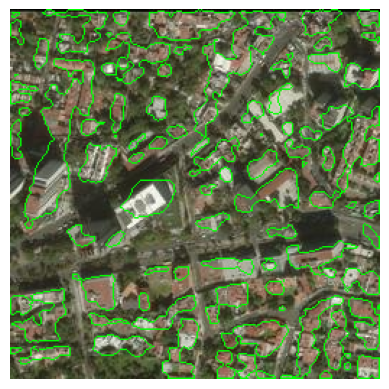


Epoch 88: val_mean_iou did not improve from 0.19509
i= 88 loss= 0.0504021979868412 val_loss= 0.2810508608818054 mean_iou= 0.19759231805801392 val_mean_iou= 0.19233866035938263
1/1 [==============================] - 0s 34ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


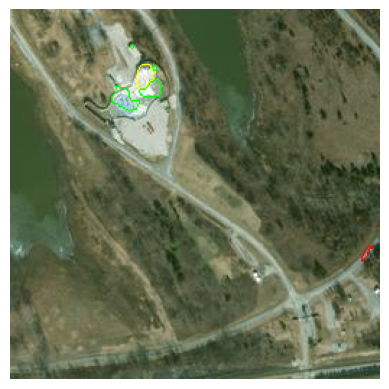


Epoch 89: val_mean_iou did not improve from 0.19509
i= 89 loss= 0.04924151301383972 val_loss= 0.2542053759098053 mean_iou= 0.19763697683811188 val_mean_iou= 0.19308866560459137
1/1 [==============================] - 0s 28ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


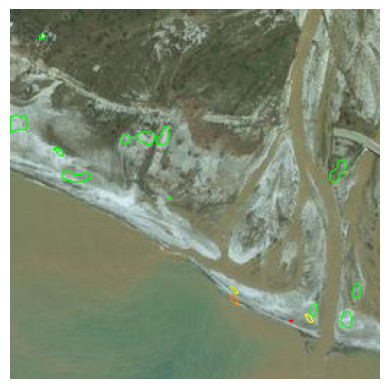


Epoch 90: val_mean_iou did not improve from 0.19509
i= 90 loss= 0.04944654554128647 val_loss= 0.21287497878074646 mean_iou= 0.19763949513435364 val_mean_iou= 0.19454830884933472
1/1 [==============================] - 0s 30ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


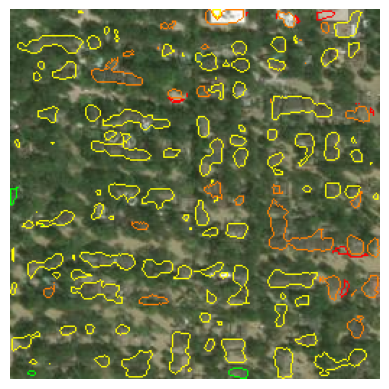


Epoch 91: val_mean_iou did not improve from 0.19509
i= 91 loss= 0.04954090341925621 val_loss= 0.29480960965156555 mean_iou= 0.1976362019777298 val_mean_iou= 0.19189338386058807
1/1 [==============================] - 0s 24ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


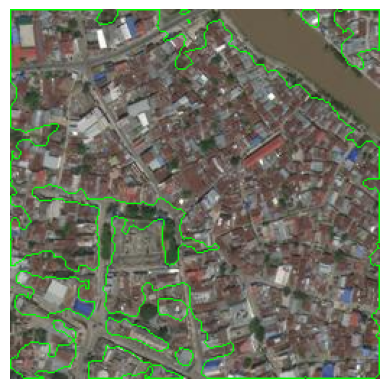


Epoch 92: val_mean_iou did not improve from 0.19509
i= 92 loss= 0.05144071951508522 val_loss= 0.1970594972372055 mean_iou= 0.19753120839595795 val_mean_iou= 0.19483938813209534
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


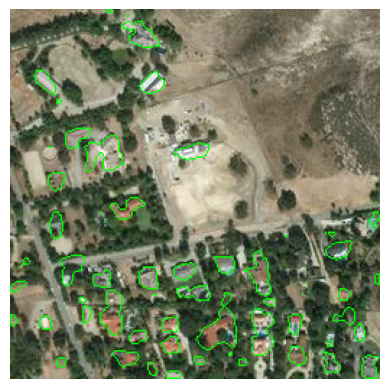


Epoch 93: val_mean_iou did not improve from 0.19509
i= 93 loss= 0.04975680634379387 val_loss= 0.19621698558330536 mean_iou= 0.19761689007282257 val_mean_iou= 0.19462154805660248
1/1 [==============================] - 0s 26ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


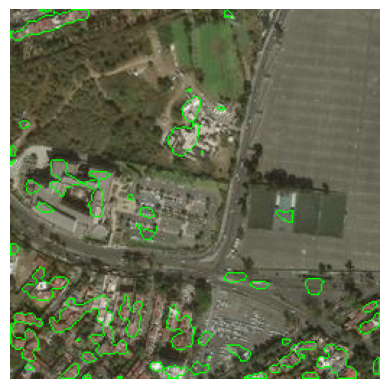


Epoch 94: val_mean_iou did not improve from 0.19509
i= 94 loss= 0.0508013553917408 val_loss= 0.2614011764526367 mean_iou= 0.19755734503269196 val_mean_iou= 0.19226224720478058
1/1 [==============================] - 0s 27ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


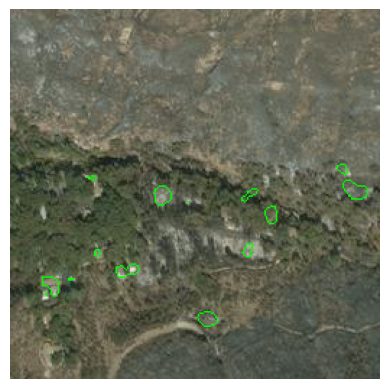


Epoch 95: val_mean_iou did not improve from 0.19509
i= 95 loss= 0.053332775831222534 val_loss= 0.24044077098369598 mean_iou= 0.19743861258029938 val_mean_iou= 0.19358758628368378
1/1 [==============================] - 0s 22ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


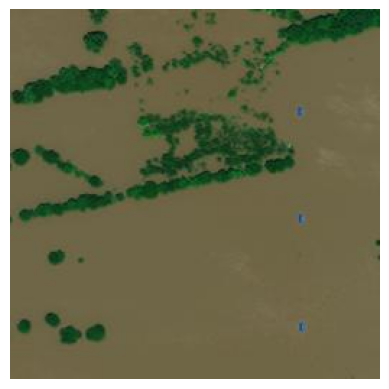


Epoch 96: val_mean_iou did not improve from 0.19509
i= 96 loss= 0.05060882866382599 val_loss= 0.2267935425043106 mean_iou= 0.1975669413805008 val_mean_iou= 0.1933310478925705
1/1 [==============================] - 0s 20ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


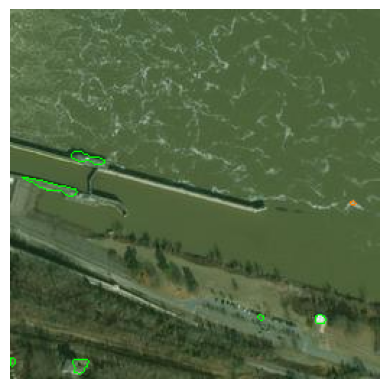


Epoch 97: val_mean_iou did not improve from 0.19509
i= 97 loss= 0.05044998601078987 val_loss= 0.28103122115135193 mean_iou= 0.19757498800754547 val_mean_iou= 0.19220806658267975
1/1 [==============================] - 0s 26ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


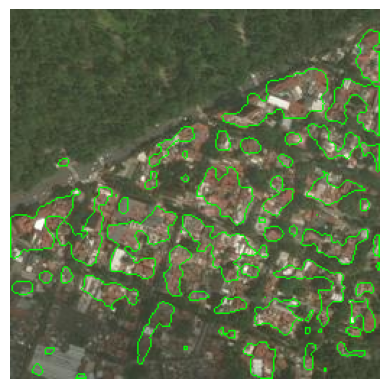


Epoch 98: val_mean_iou did not improve from 0.19509
i= 98 loss= 0.047733940184116364 val_loss= 0.23643966019153595 mean_iou= 0.19771598279476166 val_mean_iou= 0.1938447654247284
1/1 [==============================] - 0s 31ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


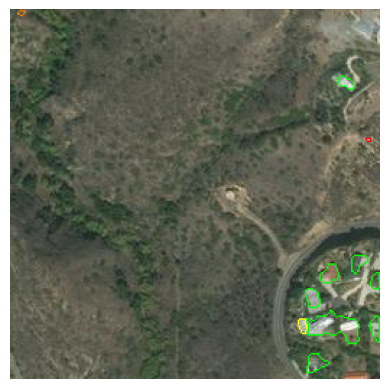


Epoch 99: val_mean_iou did not improve from 0.19509
i= 99 loss= 0.04850225895643234 val_loss= 0.2744615972042084 mean_iou= 0.1976819634437561 val_mean_iou= 0.1927558183670044
1/1 [==============================] - 0s 26ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


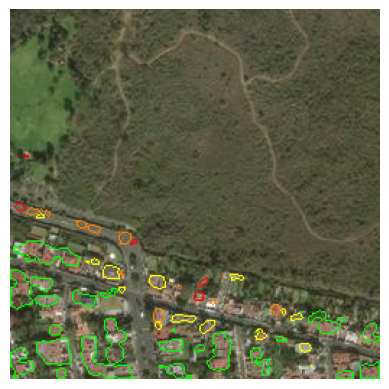


Epoch 100: val_mean_iou did not improve from 0.19509
i= 100 loss= 0.048600051552057266 val_loss= 0.2710358202457428 mean_iou= 0.19767890870571136 val_mean_iou= 0.1924123615026474
1/1 [==============================] - 0s 19ms/step
(256, 256, 5)
(256, 256)
0
(256, 256)
1
(256, 256)
2
(256, 256)
3
(256, 256)
4


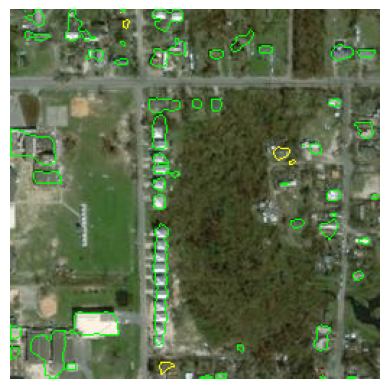

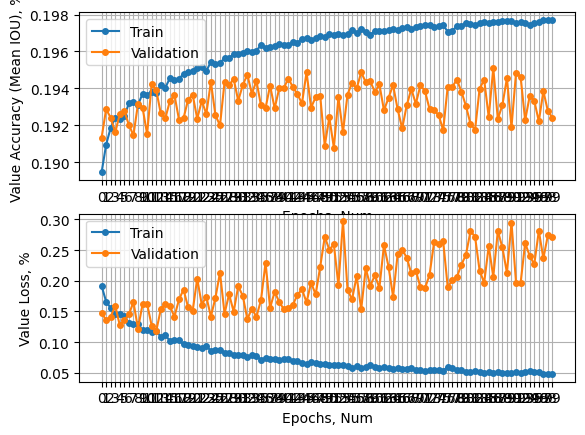

In [9]:
train_steps = len(train_files)//batch_size
test_steps = 1
model.load_weights(f'chkpt/Unet/{folder_chkpt}/learn_{n_learn - 1}/model_final[WITH_UP].h5')
model.fit_generator(train_generator, 
                    epochs = epochs, steps_per_epoch = train_steps, validation_data = test_generator, validation_steps = test_steps,
                    callbacks = build_callbacks(), verbose = 0)
model.save(f'chkpt/Unet/{folder_chkpt}/learn_{n_learn}/model_final[WITH_UP].h5')